## Compare glia to neurons

In [1]:
%matplotlib inline
import shutil
import matplotlib
matplotlib.rc('font', family='arial') 
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.interpolate import interp1d
import numpy as np
from skimage.io import imread
from fish.image.zds import ZDS
from fish.ephys.ephys import load
from os.path import exists
from os import makedirs
import pickle
from skimage.io import imread, imsave
import dask.array as da
from dask.distributed import Client

from sklearn.decomposition import NMF
from scipy.stats import zscore

from functools import partial
from dask.array import coarsen
from h5py import File
import flika as flk
import time

flk.start_flika()
from flika.window import Window as flw
from scipy.ndimage.filters import median_filter

def shift_yx(im, shifts, block_id):
    from scipy.ndimage.interpolation import shift
    t = block_id[0]    
    return shift(im.astype('float32'), (0,0, *shifts[t]), order=1, cval=100)

Starting flika
Starting flika inside IPython


In [2]:
base_dirs = ('/nrs/ahrens/Yu/SPIM/active_dataset/20170228/fish4/20170228_4_1_gfaprgeco_hucgc_6dpf_shorttrials_20170228_185002/',
             '/nrs/ahrens/Yu/SPIM/active_dataset/glia_neuron_imaging/20161109/fish2/20161109_2_1_6dpf_GFAP_GC_Huc_RG_GA_CL_fb_OL_f0_0GAIN_20161109_211950/',
            '/nrs/ahrens/Yu/SPIM/active_dataset/glia_neuron_imaging/20170221/fish5/20170221_5_3_gfaprgeco_hucgc_6dpf_wholebrain_20170221_223941/',
            '/nrs/ahrens/Yu/SPIM/active_dataset/glia_neuron_imaging/20170221/fish4/20170221_4_3_gfaprgeco_hucgc_6dpf_wholebrain_faster_brighter_20170221_174442_noephys/')

In [3]:
base_dir = base_dirs[-2]
single_plane = False
dset = ZDS(base_dir + 'raw/', single_plane=single_plane)
data = dset.data
exp_name = base_dir.split('/')[-2]
reg_dir = f'/groups/ahrens/ahrenslab/davis/tmp/{exp_name}/'
if not exists(reg_dir):
    makedirs(reg_dir)
reg_path = reg_dir + 'regparams_affine.npy'
fs_im = dset.metadata['volume_rate']

if single_plane:
    fs_im *= dset.metadata['dimensions'][-1]
try:
    shifts = -np.load(reg_path)[:,:-1,-1]
except FileNotFoundError:
    print('affines not found, registration needs to be done')
    shifts = None
    data_filt = data.map_blocks(lambda v: median_filter(v, (1,1,5,5)), dtype=data.dtype)
    mp = data.shape[0] // 2
    anat_ref = data_filt[slice(mp-5,mp+5)].mean(0).compute(scheduler='threads')

In [4]:
data.shape

(5801, 21, 2048, 2048)

In [5]:
from fish.util.distributed import get_jobqueue_cluster
cluster = get_jobqueue_cluster()
client = Client(cluster)
client

/groups/ahrens/home/bennettd/anaconda3/lib/python3.6/site-packages/distributed/bokeh/core.py:56: UserWarning: 
Port 8787 is already in use. 
Perhaps you already have a cluster running?
Hosting the diagnostics dashboard on a random port instead.
  warnings.warn('\n' + msg)


Client Scheduler: tcp://10.36.111.11:44283 Dashboard: http://10.36.111.11:38818/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


In [6]:
def mdp(data, axis, cmap):
    from skimage.exposure import rescale_intensity as rescale
    from numpy import argmax, linspace, zeros
    # max project to get intensity, then use depth to set color
    mx = rescale(data.max(axis).astype('float'), out_range=(0,1))
    remapped = zeros((*mx.shape[1:], 4))
    dp = argmax(data, axis)    
    col_array = cmap(linspace(0, 1, data.shape[axis]))
    remapped = (col_array[dp,:].transpose(2,1,0) * mx.T).transpose(2,1,0)
    
    return remapped
    

def mydff(v):
    from fish.image.vol import dff
    camera_offset = 80
    window = 300 * fs_im
    percentile = 20
    offset = 10    
    downsample = 10;
    return dff((v - camera_offset).clip(1, None), window, percentile, offset, downsample, axis=0).astype('float32')


def reg(fixed, moving):
    from fish.image.alignment import estimate_translation
    from numpy import expand_dims
    affs =  estimate_translation(fixed.squeeze(), moving.squeeze()).affine
    return expand_dims(affs, 0)

def redim(array, ndim, shape=None):
    
    if (ndim > array.ndim) and (shape == None):
        raise ValueError('Cannot expand dimensions without supplying a shape argument')
    if ndim < array.ndim:
        new_shape = (*array.shape[:(ndim-1)], np.prod(array.shape[(ndim-1):]))
    elif ndim > array.ndim:
        new_shape = shape
    elif ndim == array.ndim:
        new_shape = array.shape
        
    return array.reshape(new_shape)

In [7]:
if shifts is None:
    cluster.start_workers(100)
    reg_roi = (slice(None), slice(None), slice(None), slice(None))
    ref_mx_bc = client.scatter(anat_ref[reg_roi[1:]].max(0), broadcast=True)
    data_filt = data[reg_roi].map_blocks(lambda v: median_filter(v, (1,1,5,5)), dtype=data.dtype)
    affines = da.map_blocks(reg, ref_mx_bc, data_filt.max(1), dtype='float32', chunks=(1,2,2)).compute()    
    np.save(reg_path, affines)
    shifts = -affines[:,:-1,-1]
    cluster.stop_all_jobs()

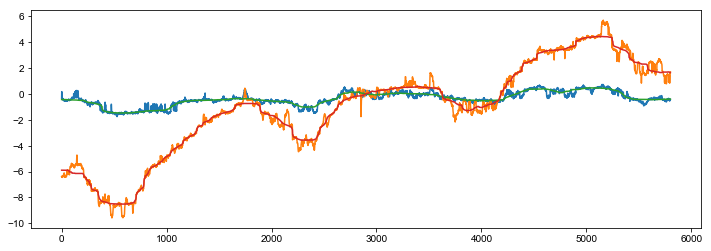

In [7]:
fig, axs = plt.subplots(figsize=(12,4))
axs.plot(shifts)
shifts_filt = median_filter(shifts, size=(300,1))
axs.plot(shifts_filt);

In [10]:
%%time
cluster.start_workers(50)
std_plr = np.arange(-50,50) + data.shape[0] // 2
std_vol = data[std_plr].std(0).compute()
cluster.stop_all_jobs()

CPU times: user 14.8 s, sys: 2.61 s, total: 17.4 s
Wall time: 2min 55s


In [12]:
flw(std_vol)

/groups/ahrens/home/bennettd/anaconda3/lib/python3.6/site-packages/pyqtgraph/imageview/ImageView.py:588: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  data = data[sl]


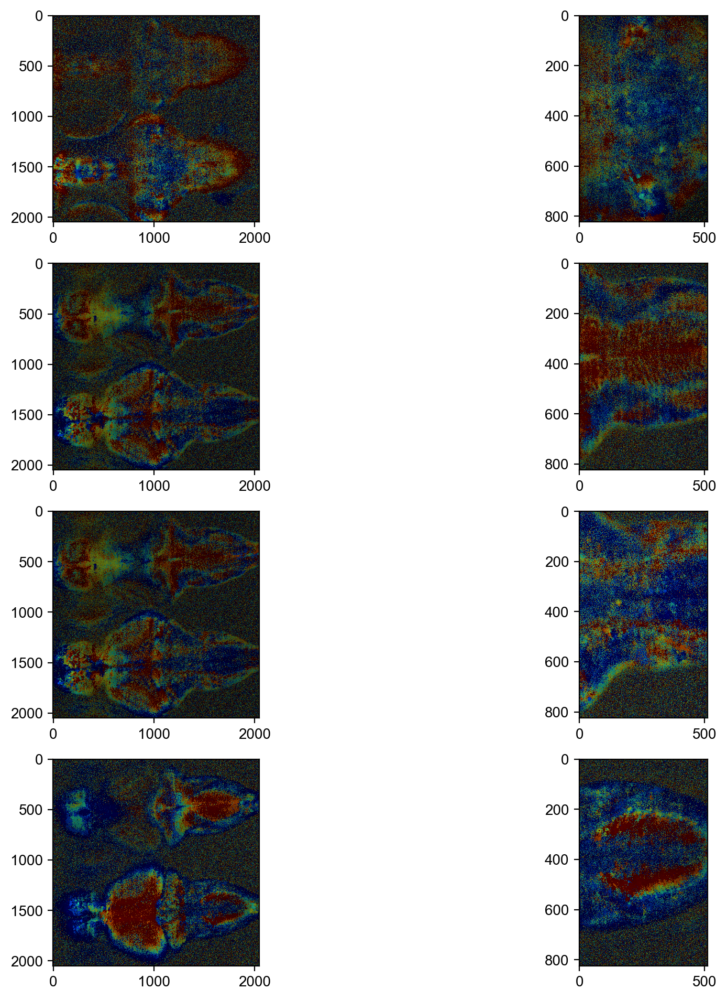

In [13]:
from matplotlib.cm import jet
def ds_roi(roi, ds):
    t = roi[0]
    z = roi[1]
    y = slice(roi[2].start // ds, roi[2].stop//ds)
    x = slice(roi[3].start // ds, roi[3].stop//ds)
    return t,z,y,x

rois = {}

roi_y = np.array([100, 924])
roi_x = np.array([0, 512])
roi_t = slice(None)
rois['lc'] = (roi_t, slice(0,6,1), slice(*(1040 + roi_y)), slice(*(800 + roi_x)))
rois['lh_g'] = (roi_t, slice(8,14,1), slice(*(0 + roi_y)), slice(*(1200 + roi_x)))
rois['lh_n'] = (roi_t, slice(8,14,1), slice(*(1050 + roi_y)), rois['lh_g'][-1]) 
rois['swim'] = (roi_t, slice(12,18,1), slice(*(1000 + roi_y)), slice(*(1400 + roi_x)))
fig, axs = plt.subplots(ncols=2,nrows=len(rois), dpi=200, figsize=(12,12))
for ind, roi_ in enumerate(rois.values()):
    axs[ind,0].imshow(mdp(np.log(std_vol)[roi_[1]], axis=0, cmap=jet)[:,:,:-1])
    axs[ind,1].imshow(mdp(np.log(std_vol)[roi_[1:]], axis=0, cmap=jet)[:,:,:-1])
plt.subplots_adjust(wspace=0)

In [9]:
def get_dff_roi(data, roi, ds_xy=1):
    data_crop = data[roi]
    data_tx = data_crop.map_blocks(shift_yx, shifts, dtype='float32')
    medfilt = partial(median_filter, size=(1,1,3,3))
    data_filt = data_tx.map_blocks(medfilt)
    data_ds = coarsen(np.mean, data_filt, {2: ds_xy, 3: ds_xy})
    rechunked = data_ds.rechunk(chunks=(data_ds.shape[0], 1, 'auto','auto'))
    data_dff = rechunked.map_blocks(mydff, dtype='float32')
    return data_dff

In [15]:
arrs = [get_dff_roi(data, r, 4) for r in rois.values()]

In [ ]:
cluster.start_workers(300)
result = da.stack(arrs, axis=0).compute()
cluster.stop_all_jobs()

In [18]:
from skimage.io import imsave
import pickle

with open(f'{reg_dir}chunked_rois.pickle', 'wb') as f:
    pickle.dump(rois,f)

out_path = reg_dir + f'{exp_name}_chunked_dff.tif'
imsave(out_path, result, imagej=True)

/groups/ahrens/home/bennettd/anaconda3/lib/python3.6/site-packages/skimage/external/tifffile/tifffile.py:1088: UserWarning: truncating ImageJ file
  warnings.warn("truncating ImageJ file")


In [8]:
with open(f'{reg_dir}chunked_rois.pickle', 'rb') as f:
    rois = pickle.load(f)

out_path = reg_dir + f'{exp_name}_chunked_dff.tif'
result = imread(out_path)

In [9]:
trim = slice(5,-5)
stacked = np.concatenate([result[0,:,2,trim,trim], result[1,:,2,trim,trim], result[2,:,2,trim,trim]],2)

In [10]:
win = flw(stacked)

/groups/ahrens/home/bennettd/anaconda3/lib/python3.6/site-packages/pyqtgraph/imageview/ImageView.py:588: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  data = data[sl]


In [11]:
rois_ts = np.array([stacked.T[r.getMask()[::-1]].mean(0) for r in win.rois]).T

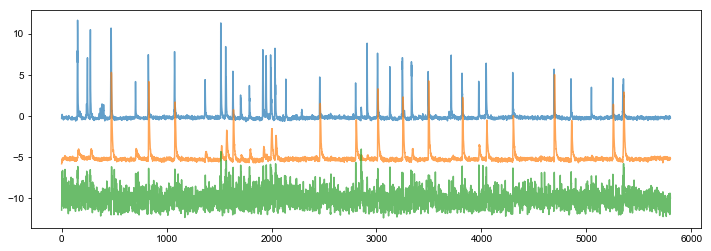

In [12]:
from scipy.stats import zscore
fig, axs=plt.subplots(figsize=(12,4))
zsc = zscore(rois_ts,0)
axs.plot(zsc - 5 * np.arange(rois_ts.shape[1]), alpha=.7)
#axs.set_xlim(0,1000)

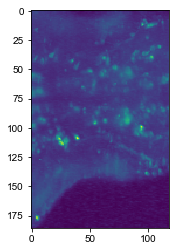

In [16]:
to_factorize = result[2,:,:,10:-10,5:-5].copy()
plt.imshow(to_factorize.std(0).max(0))

In [24]:
%%time
tf_flat = redim(to_factorize, ndim=2).T
tf_flat += 1 + tf_flat.min()
fact = NMF(n_components=60, random_state=0).fit(tf_flat)
w_flat = fact.transform(tf_flat)
w = w_flat.reshape((*to_factorize.shape[1:],-1)).transpose(-1,0,1,2)

CPU times: user 57min 17s, sys: 30 s, total: 57min 47s
Wall time: 9min 58s


In [13]:
nmf_fname = reg_dir + 'NMF.pickle'

In [26]:
with open(nmf_fname, 'wb') as f:
    pickle.dump((fact, w), f)

In [14]:
with open(nmf_fname, 'rb') as f:
   fact, w = pickle.load(f)

In [15]:
ptp_order = np.argsort(w.ptp(axis=(1,2,3)))[::-1]

In [16]:
comp_ts_zsc = zscore(fact.components_, axis=1)

In [17]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure, show
from bokeh.layouts import gridplot
output_notebook()

Loading BokehJS ...

In [36]:
plr_t = np.arange(0,data.shape[0])
wh,ht = 250,250
gp = []
comp_ts_zsc = zscore(fact.components_, 1)

for ind, comp in enumerate(ptp_order[:40]):    
    pl = []
    weight_ = w[comp].max(0)[::-1]
    comp_ts = comp_ts_zsc[comp]    
    xr = None
    yr = None
    if len(gp) >= 1:
        xr = gp[0][1].x_range
        yr = gp[0][1].y_range
    pl.append(figure(width=wh, 
                     height=ht,
                     x_range=(0, max(weight_.shape)),
                     y_range=(0, max(weight_.shape)),
                    title=f'{comp}'))
    
    pl.append(figure(width=wh * 2, height=ht, title=None, x_range=xr, y_range=yr))
    pl[0].image([weight_], 0, 0, weight_.shape[1], weight_.shape[0], palette='Magma256')
    pl[1].line(plr_t, comp_ts)
    pl[1].line(plr_t, zsc[plr_t,1], line_color='black')
    gp.append(pl)
    
p = gridplot(gp)
show(p)

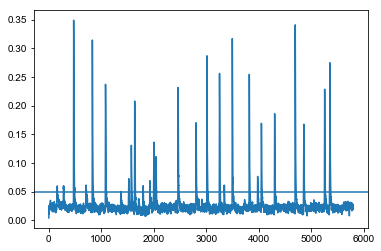

In [17]:
# trigger on glial peaks
thr = .05
plt.plot(rois_ts[:,1])
plt.axhline(thr)

In [18]:
from fish.ephys.ephys import estimate_onset
trigs = estimate_onset(rois_ts[:,1], .05, duration=40)[1:]
plr = np.arange(-20,50)
trials = trigs + plr.reshape(-1,1)
tr_sorted_g = trials[:, np.argsort(zsc[trials, 1].max(0))[::-1]]
tr_sorted_n = trials[:, np.argsort(zsc[trials, 2].max(0))[::-1]]


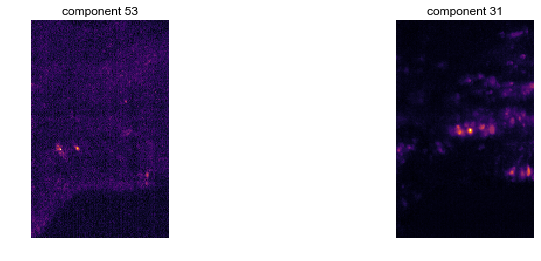

In [49]:
cmps = ptp_order[40:42]
fig, axs = plt.subplots(ncols=len(cmps), figsize=(12,4))
for ind, val in enumerate(cmps):
    axs[ind].imshow(w[val].max(0), cmap='inferno')
    axs[ind].title.set_text(f'component {val}')
    axs[ind].axis('off')

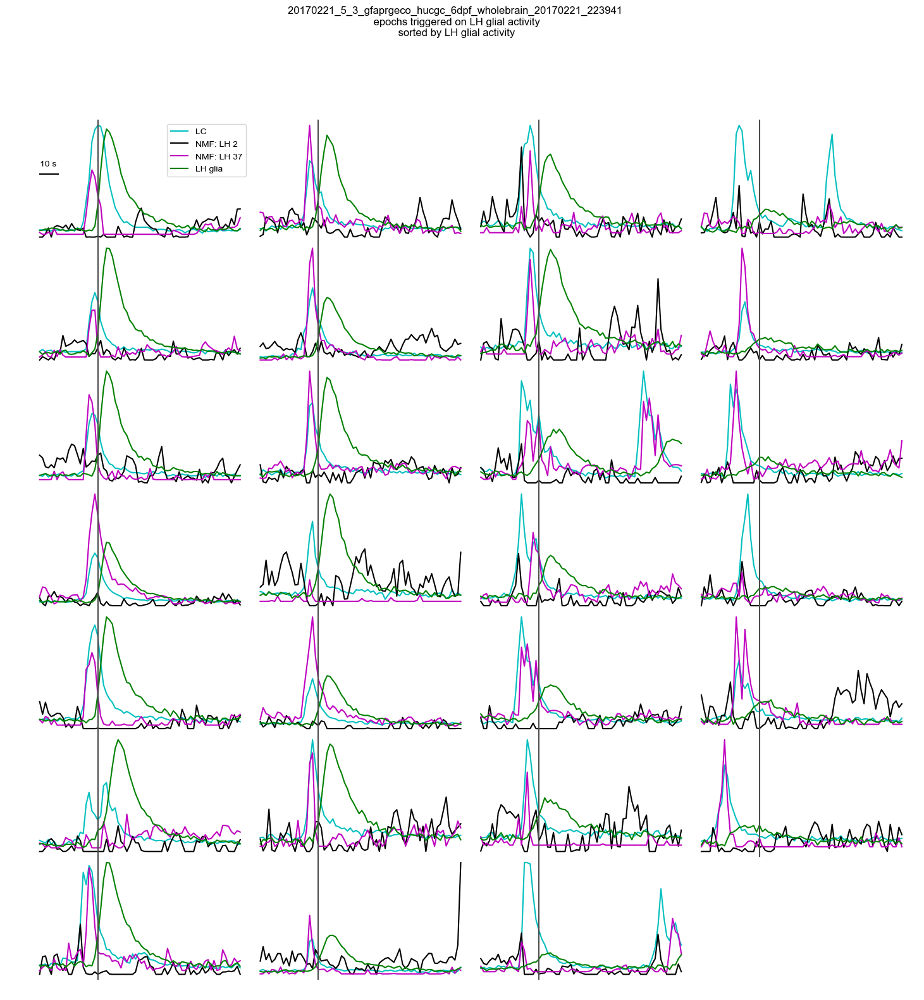

In [50]:
ncols = 4
fig, axs = plt.subplots(figsize=(18,18), ncols=ncols, nrows=np.ceil(trials.shape[1] / ncols).astype('int'), dpi=100)

sig1 = comp_ts_zsc[ptp_order[42]]
sig2 = comp_ts_zsc[ptp_order[43]]
#sig1 = comp_ts_zsc[2]
#sig2 = comp_ts_zsc[37]

plr_t = plr * fs_im
colors = ('c','k', 'm', 'g')
to_plot = (zsc[:,0], sig1, sig2, zsc[:,1])
labels = ('LC','NMF: LH 2', 'NMF: LH 37', 'LH glia')

[ax.axis('off') for ax in axs.ravel()]
for ind, trial in enumerate(tr_sorted_g.T):
    curax = axs.T.ravel()[ind]
    [curax.plot(plr_t, val[trial], color=colors[ind], label=labels[ind]) for ind, val in enumerate(to_plot)]
    curax.axvline(0, color=(.3,.3,.3))
    

scale_bar_len = 10
scale_bar_pos = [plr_t[0],plr_t[0] + scale_bar_len], [axs[0][0].get_ylim()[-1]/2] * 2
axs[0][0].plot(*scale_bar_pos, color='k')
axs[0][0].text(scale_bar_pos[0][0], scale_bar_pos[1][0] * 1.15, f'{scale_bar_len} s')
axs[0][0].legend()
plt.suptitle(f'{exp_name} \n epochs triggered on LH glial activity \n sorted by LH glial activity ')
plt.subplots_adjust(hspace=0,wspace=0)

In [113]:
## Search for the MO

putative_ne = np.concatenate([result[0,:,:,trim, trim], result[-1,:,:,trim, trim]], -1)

In [114]:
putative_ne.shape

(6013, 6, 196, 236)

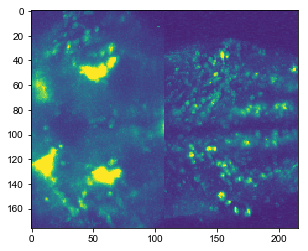

In [117]:
ne_roi = slice(None), slice(None), slice(10, -10), slice(10, -10)
plt.imshow(putative_ne[ne_roi].max((0,1)), clim=(0,1))

In [119]:
to_fact.shape

(6013, 6, 176, 216)

In [127]:
%%time
to_fact = putative_ne[ne_roi]
tf_flat = redim(to_fact, ndim=2).T
tf_flat += 1 + tf_flat.min()
fact_ne = NMF(n_components=60, random_state=0).fit(tf_flat)
w_flat_ne = fact_ne.transform(tf_flat)
w_ne = w_flat_ne.reshape((*to_fact.shape[1:],-1)).transpose(-1, *range(to_fact.ndim-1))

CPU times: user 1h 38min 23s, sys: 48 s, total: 1h 39min 11s
Wall time: 18min 49s


In [128]:
w_ne.shape

(60, 6, 176, 216)

In [129]:
flw(w_ne.max(1))

/groups/ahrens/home/bennettd/anaconda3/lib/python3.6/site-packages/pyqtgraph/imageview/ImageView.py:588: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  data = data[sl]


# get the trace of the lc

In [50]:
flw(result[-1].max(1))

/groups/ahrens/home/bennettd/anaconda3/lib/python3.6/site-packages/pyqtgraph/imageview/ImageView.py:588: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  data = data[sl]


Text(0.5, 0, 'LH Neurons')

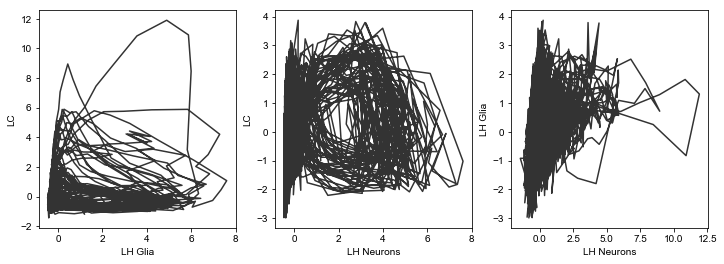

In [242]:
fig, axs = plt.subplots(ncols=3, figsize=(12,4))
alpha = .8
color='k'
axs[0].plot(zsc[:,0], zsc[:,1], color=color, alpha=alpha)
axs[0].set_ylabel('LC')
axs[0].set_xlabel('LH Glia')

axs[1].plot(zsc[:,0], zsc[:,2], color=color, alpha=alpha)
axs[1].set_ylabel('LC')
axs[1].set_xlabel('LH Neurons')

axs[2].plot(zsc[:,1], zsc[:,2], color=color, alpha=alpha)
axs[2].set_ylabel('LH Glia')
axs[2].set_xlabel('LH Neurons')

In [ ]:
thr = .3
plt.imshow(lc_plane.max(0), clim = (thr, None))

In [72]:
lc_plane_thr = lc_plane.T[lc_plane.max(0).T > thr]

In [73]:
from sklearn.cluster import KMeans

In [74]:
kmm = KMeans(n_clusters=10).fit(lc_plane_thr)

In [75]:
km_ts = kmm.cluster_centers_.T

In [66]:
rois_ts = np.array([lc_plane.T[r.getMask()[::-1]].mean(0) for r in win.rois]).T

In [77]:
def get_lr_result(v, regressors):
    from sklearn.linear_model import LinearRegression
    lr = LinearRegression()
    lr_result = lr.fit(regressors, v.reshape(v.shape[0], np.prod(v.shape[1:])))
    coeffs = lr_result.coef_.reshape((1, *v.shape[1:], regressors.shape[-1]))
    return coeffs

In [78]:
tmp = get_lr_result(lc_plane, km_ts).squeeze().transpose(2,0,1)

In [79]:
flw(tmp)

In [80]:
from functools import partial
parf = partial(get_lr_result, regressors=km_ts)
lr_result = data_dff_mem.map_blocks(parf, dtype='float32', new_axis=4).compute()
lr_result = lr_result.squeeze().transpose(3,0,1,2)

distributed.utils_perf - WARNING - full garbage collections took 18% CPU time recently (threshold: 10%)


In [81]:
lr_result.shape

(10, 22, 512, 512)

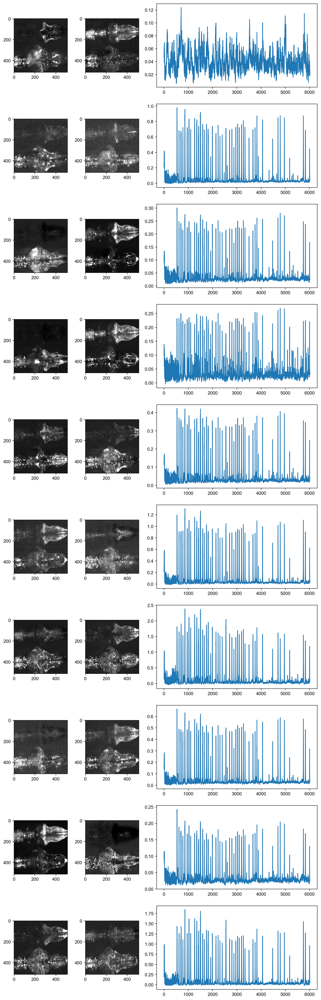

In [82]:
nr = lr_result.shape[0]
fig, axs = plt.subplots(nrows=nr, ncols=3, figsize=(12, 4 * nr), gridspec_kw={'width_ratios' : (1,1,3)}, dpi=200)
for ind, t in enumerate(lr_result):
    axs[ind,0].imshow(t.max(0), clim=(0, np.percentile(t, 99.9)), cmap='gray')
    axs[ind,1].imshow(t.min(0), clim=(np.percentile(t, .1), 0), cmap='gray_r')
    axs[ind,-1].plot(km_ts[:,ind])
    

In [94]:
def get_dff_data(data):
    data_tx = data.map_blocks(shift_yx, shifts, dtype='float32')
    medfilt = partial(median_filter, size=(1,1,5,5))
    data_filt = data_tx.map_blocks(medfilt)
    ds_xy = 4
    data_ds = coarsen(np.mean, data_filt, {2: ds_xy, 3: ds_xy})
    rechunked = data_ds.rechunk(chunks=(data_ds.shape[0], 1, 'auto','auto'))
    data_dff = rechunked.map_blocks(mydff, dtype='float32')
    return data_dff

In [179]:
cluster.stop_all_jobs()

In [ ]:
import time
cluster.start_workers(500)
results_dff = {k :get_dff_data(dset.data[r]).compute().squeeze() for k, r in rois.items()}
time.sleep(2)
cluster.stop_all_jobs()

In [180]:
shapes = [r.shape for r in results_dff.values()]

In [183]:
pw = results_dff['lh_g'].shape[1] - results_dff['lc'].shape[1]
pad_width = ((0,0), (pw//2, pw//2), (0,0)) 
padded = np.pad(results_dff['lc'], pad_width, mode='constant')
fused = np.concatenate((padded, results_dff['lh_g'], results_dff['lh_n'], results_dff['swim']), axis=2)
win = flw(fused)

In [242]:
from skimage.io import imsave
fname = f'/groups/ahrens/ahrenslab/davis/tmp/{exp_name}_stitched.tif'
imsave(fname, fused)

In [191]:
masks = [m.getMask() for m in win.rois]

In [244]:
import pickle

In [246]:
fname_masks = f'/groups/ahrens/ahrenslab/davis/tmp/{exp_name}_masks.pickle'
with open(fname_masks, 'wb') as fh:
    pickle.dump(masks, fh)

In [210]:
from fish.ephys.ephys import estimate_onset
cam_trig = estimate_onset(np.diff(cam), .8, 100)

Text(0.5, 0, 'Time (s)')

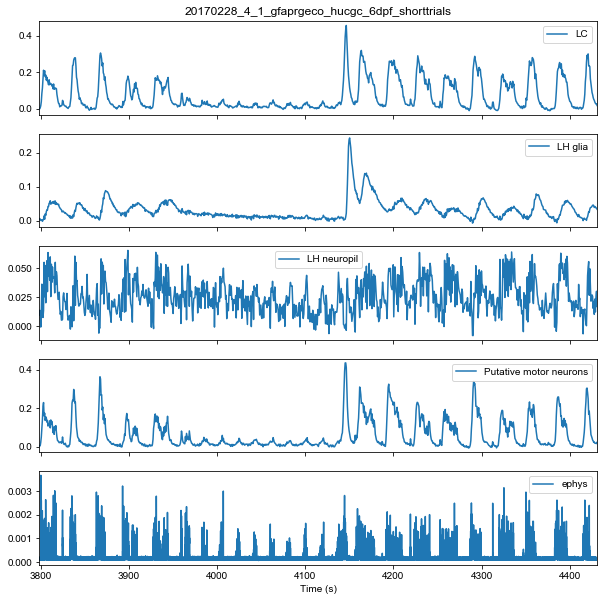

In [239]:
fig, axs = plt.subplots(nrows=len(masks) + 1, figsize=(10,10), sharex=True)
plr = slice(6000, 7000)
x_axis_im = cam_trig[plr] / 6000
labels = ['LC', 'LH glia', 'LH neuropil', 'Putative motor neurons']
for ind, m in enumerate(masks):
    axs[ind].plot(x_axis_im, fused[:, m[0], m[1]].mean(1)[plr], label=labels[ind])
    axs[ind].set_xlim(x_axis_im[0], x_axis_im[-1])
    axs[ind].legend()
x_axis_ep = np.arange(cam_trig[plr][0], cam_trig[plr][-1]) / 6000
axs[0].title.set_text(exp_name)
axs[-1].plot(x_axis_ep, swims[cam_trig[plr][0] : cam_trig[plr][-1]], label='ephys')
axs[-1].legend()
axs[-1].set_xlabel('Time (s)')

In [ ]:
import random

def make_document(doc):
    source = ColumnDataSource({'x': [], 'y': [], 'color': []})

    def update():
        new = {'x': [random.random()],
               'y': [random.random()],
               'color': [random.choice(['red', 'blue', 'green'])]}
        source.stream(new)

    doc.add_periodic_callback(update, 100)

    fig = figure(title='Streaming Circle Plot!', sizing_mode='scale_width',
                 x_range=[0, 1], y_range=[0, 1])
    fig.circle(source=source, x='x', y='y', color='color', size=10)

    doc.title = "Now with live updating!"
    doc.add_root(fig)

apps = {'/': Application(FunctionHandler(make_document))}

server = Server(apps, port=5001, )
server.start()

In [ ]:
server.stop()